# Data augmentation with imgaug
- imgaug를 사용한 이미디 데이터 확장
- Link : https://github.com/aleju/imgaug
<img src='https://raw.githubusercontent.com/aleju/imgaug/master/examples_grid.jpg' />

### csv file
- 이미지 데이터 리스트와 라벨 리스트가 들어있는 csv 파일 Load

In [1]:
def read_labeled_image_list_from_csv(image_list_file, path, image_format):
    """Reads a .csv file containing pathes and labeles
    Args:
       image_list_file: a .txt file with one /path/to/image per line
       label: optionally, if set label will be pasted after each line
    Returns:
       List with all filenames in file image_list_file
    """
    f = open(image_list_file, 'r')
    filenames = []
    labels = []
    except_title = False
    for line in f:
        #print(line)
        if except_title:
            filename, label = line[:-1].split(',')
            filename = path + filename + '.' + image_format
            filenames.append(filename)
            labels.append(int(label))
        if except_title == False:
            except_title = True
            
    return filenames, labels

In [2]:
filename = '../Species/data/train_labels.csv'

image_list, label_list = read_labeled_image_list_from_csv(filename,'../Species/data/train/' ,'jpg')

### Matplotlib.pyplot과 PIL
- image_list 경로의 이미지 불러오기
- pyplot으로 이미지 출력하기

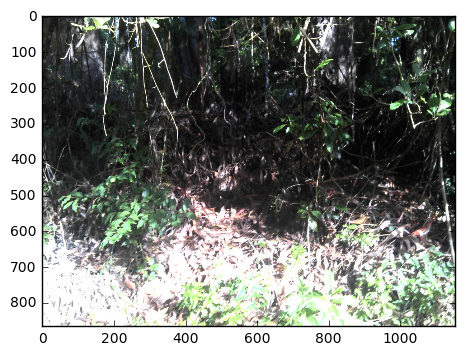

In [3]:
from matplotlib.pyplot import imshow
from PIL import Image
import numpy as np
%matplotlib inline

imagedata_list = []
for i in range(20):
    im = Image.open(image_list[i])
    im = np.asarray(im)
    imagedata_list.append(im)
imshow(im)

## imgaug를 이용한 augmentation
- augmentation method
<img src='https://raw.githubusercontent.com/aleju/imgaug/master/examples.jpg' />

In [4]:
import imgaug as ia
from imgaug import augmenters as iaa

# Sometimes(0.5, ...) applies the given augmenter in 50% of all cases,
# e.g. Sometimes(0.5, GaussianBlur(0.3)) would blur roughly every second image.
sometimes = lambda aug: iaa.Sometimes(0.5, aug)

# Define our sequence of augmentation steps that will be applied to every image
# All augmenters with per_channel=0.5 will sample one value _per image_
# in 50% of all cases. In all other cases they will sample new values
# _per channel_.
seq = iaa.Sequential(
    [
        # apply the following augmenters to most images
        iaa.Fliplr(0.5), # horizontally flip 50% of all images
        iaa.Flipud(0.2), # vertically flip 20% of all images
        sometimes(iaa.Crop(percent=(0, 0.1))), # crop images by 0-10% of their height/width
        sometimes(iaa.Affine(
            scale={"x": (0.8, 1.2), "y": (0.8, 1.2)}, # scale images to 80-120% of their size, individually per axis
            translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)}, # translate by -20 to +20 percent (per axis)
            rotate=(-25, 25), # rotate by -25 to +25 degrees
            shear=(-16, 16), # shear by -16 to +16 degrees
            order=[0, 1], # use nearest neighbour or bilinear interpolation (fast)
            cval=(0, 255), # if mode is constant, use a cval between 0 and 255
            mode=ia.ALL # use any of scikit-image's warping modes (see 2nd image from the top for examples)
        )),
        # execute 0 to 5 of the following (less important) augmenters per image
        # don't execute all of them, as that would often be way too strong
        iaa.SomeOf((0, 5),
            [
                #sometimes(iaa.Superpixels(p_replace=(0, 1.0), n_segments=(20, 200))), # convert images into their superpixel representation
                iaa.OneOf([
                    iaa.GaussianBlur((0, 1.0)), # blur images with a sigma between 0 and 1.0
                    iaa.AverageBlur(k=(2, 5)), # blur image using local means with kernel sizes between 2 and 5
                    iaa.MedianBlur(k=(3, 5)), # blur image using local medians with kernel sizes between 3 and 5
                ]),
                iaa.Sharpen(alpha=(0, 1.0), lightness=(0.75, 1.5)), # sharpen images
                #iaa.Emboss(alpha=(0, 1.0), strength=(0, 2.0)), # emboss images
                # search either for all edges or for directed edges
                #sometimes(iaa.OneOf([
                #    iaa.EdgeDetect(alpha=(0, 0.7)),
                #    iaa.DirectedEdgeDetect(alpha=(0, 0.7), direction=(0.0, 1.0)),
                #])),
                iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5), # add gaussian noise to images
                iaa.OneOf([
                    iaa.Dropout((0.01, 0.1), per_channel=0.5), # randomly remove up to 10% of the pixels
                    #iaa.CoarseDropout((0.03, 0.15), size_percent=(0.02, 0.05), per_channel=0.2),
                ]),
                #iaa.Invert(0.05, per_channel=True), # invert color channels
                iaa.Add((-10, 10), per_channel=0.5), # change brightness of images (by -10 to 10 of original value)
                iaa.Multiply((0.5, 1.5), per_channel=0.5), # change brightness of images (50-150% of original value)
                iaa.ContrastNormalization((0.5, 2.0), per_channel=0.5), # improve or worsen the contrast
                iaa.Grayscale(alpha=(0.0, 0.2)),
                sometimes(iaa.ElasticTransformation(alpha=(0.1, 1.5), sigma=0.25)), # move pixels locally around (with random strengths)
                sometimes(iaa.PiecewiseAffine(scale=(0.01, 0.03))) # sometimes move parts of the image around
            ],
            random_order=True
        )
    ],
    random_order=True
)

- augmentation 수행

In [5]:
imagedata_aug_list = seq.augment_images(imagedata_list)

- show 가능한 이미지 포맷으로 변환

In [8]:
img = []
img_aug = []
for i in range(20):
    img.append(Image.fromarray(imagedata_list[i], 'RGB'))
    img_aug.append(Image.fromarray(imagedata_aug_list[i], 'RGB'))

- 8x5 로 이미지 출력
- 1번째 row : 원본 이미지
- 2번째 row : augmented 이미지

In [9]:
import matplotlib.pyplot as plt
plt.figure(figsize=(50, 80))
j = 0
k = 0
for i in range(40):
    plt.subplot(8,5,i+1)
    if int((i / 5) % 2) == 0:
        fig = plt.imshow(imagedata_list[j])
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
        j += 1
    else:
        fig = plt.imshow(imagedata_aug_list[k])
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
        k += 1